In [1]:
# The code was removed by Watson Studio for sharing.

# Analysis of libraries in New York City

In this notebook, I want to analyze a combination of geographic data from Foursquare and socioeconomic data from the United States Census to find out whether public libraries in New York City are fairly distributed across more-privileged and less-privileged neighborhoods.

I will use Foursquare to count the number of libraries in each neighborhood, and then I will look for correlations between the library count and each of these socioeconomic variables: 
* Population size
* Median income
* Percent of population with a disability
* Percent of population that is white
* Poverty rate
* Percent of population born outside the U.S.
* Percent of population older than age 65

#### Collecting the Data

Import the necessary prerequisites:

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 

# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library

print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/DSX-Python35

  added / updated specs: 
    - folium=0.5.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    branca-0.3.1               |             py_0          25 KB  conda-forge
    folium-0.5.0               |             py_0          45 KB  conda-forge
    vincent-0.4.4              |             py_1          28 KB  conda-forge
    altair-2.2.2               |           py35_1         462 KB  conda-forge
    certifi-2018.8.24          |        py35_1001         139 KB  conda-forge
    openssl-1.0.2r             |       h14c3975_0         3.1 MB  conda-forge
    ca-certificates-2019.3.9   |       hecc5488_0         146 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         4.0 MB

The following NEW packages will

New York City is subdivided into areas called Public Use Microdata Areas, or PUMAs, for U.S. Census data collection. The census data for each area is available for download [here](http://app.coredata.nyc/?mlb=true&ntii=hh_inc_med_adj&ntr=Sub-Borough%20Area&mz=14&vtl=https%3A%2F%2Fthefurmancenter.carto.com%2Fu%2Fnyufc%2Fapi%2Fv2%2Fviz%2F691a2b7c-94d7-46ac-ac4d-9a589cb2c6ed%2Fviz.json&mln=true&mlp=true&mlat=40.718&ptsb=&nty=2017&mb=roadmap&pf=%7B%22subsidies%22%3Atrue%7D&md=table&mlv=false&mlng=-73.996&btl=Sub-Borough%20Area&atp=neighborhoods), so I have already downloaded the individual spreadsheets for each of my variables of interest and combined them into a single CSV file.


Load the CSV file with the census data for the PUMAs:

In [3]:
census_df = pd.read_csv(project.get_file('NY_neighborhoods_data.csv'))
census_df.head(10)

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID
0,Astoria,164321,67647.98474,0.045656,0.474918,0.130441,0.367713,0.125206,4101
1,Bay Ridge,123488,69988.79130,0.065624,0.508584,0.151506,0.387997,0.171021,4013
2,Bayside/Little Neck,118670,71492.94040,0.045422,0.375074,0.097564,0.445698,0.227218,4104
3,Bedford Stuyvesant,142027,52896.92904,0.087774,0.266111,0.243765,0.184127,0.103304,4003
4,Bensonhurst,205850,54513.17598,0.061549,0.404469,0.172610,0.556259,0.142521,4017
5,Borough Park,146556,46229.14615,0.060802,0.688945,0.308085,0.279279,0.144812,4014
6,Brooklyn Heights/Fort Greene,135444,94327.26889,0.087317,0.472143,0.148676,0.187694,0.107292,4004
7,Brownsville/Ocean Hill,111511,20640.26819,0.114748,0.042579,0.398762,0.261562,0.121997,4007
8,Bushwick,140474,51622.07097,0.069588,0.214844,0.271181,0.302996,0.074149,4002
9,Central Harlem,147442,49994.61425,0.087135,0.148730,0.235349,0.251672,0.113753,3803


Most of these variables are in the format of a percentage; that is, between 0 and 1, which means they are already normalized, but Population and Median_income are much larger and might disproportionately affect the analysis later, so I will normalize them both now with simple feature scaling.

In [4]:
#scale the two columns by dividing by their maximum values:
census_df['Population'] = census_df['Population']/census_df['Population'].max()
census_df['Median_income'] = census_df['Median_income']/census_df['Median_income'].max()
census_df.head()

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID
0,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,4101
1,Bay Ridge,0.474439,0.474047,0.065624,0.508584,0.151506,0.387997,0.171021,4013
2,Bayside/Little Neck,0.455929,0.484235,0.045422,0.375074,0.097564,0.445698,0.227218,4104
3,Bedford Stuyvesant,0.545666,0.358281,0.087774,0.266111,0.243765,0.184127,0.103304,4003
4,Bensonhurst,0.790873,0.369228,0.061549,0.404469,0.172610,0.556259,0.142521,4017


Now that the census data is fully normalized, I will need to connect it to the latitude/longitude coordinates. 

The geodata for the PUMAs is available [here](https://geo.nyu.edu/catalog/nyu-2451-34562), which I will load now and process to obtain latitude and longitude coordinates for each PUMA in the above dataframe.

In [5]:
!wget -q -O 'newyork_puma_data.json' https://geo.nyu.edu/download/file/nyu-2451-34562-geojson.json
print('Data downloaded!')

Data downloaded!


In [6]:
with open('newyork_puma_data.json') as json_data:
    newyork_puma_data = json.load(json_data)

In [7]:
puma_data = newyork_puma_data['features']

Examine the "Properties" section of the first entry to see what data fields are available to work with:

In [8]:
puma_data[0]['properties']

{'bbox': [-73.92490327473082,
  40.86606885121164,
  -73.8856751802567,
  40.91553277700519],
 'puma': '3701',
 'shape_area': 97932776.767,
 'shape_leng': 53287.1770536}

The 'puma' field holds the same data as the PUMA_ID field in the census_df dataframe, so that column can be used to equate the PUMAs in the geodata to the PUMAs in the census data. Additionally, the 'bbox' field tells us the maximum and minimum latitude and longitude for each PUMA, so taking the means of the bbox coordinates will give the location of the approximate center of the PUMA (which can be used later as the center of each Foursquare search.) For this we will need to import the 'mean' package:

In [9]:
from statistics import mean

Let's loop through the GeoJSON file and pull out the PUMA ID and the averaged (center) latitude and longitude for each PUMA and put them into a new dataframe.

In [10]:
#Create a blank dataframe to hold the relevant geodata
latlongcolumns = ['PUMA_ID','Latitude','Longitude'] #provide a list of column names
geo_df = pd.DataFrame(columns=latlongcolumns) #instantiate the empty dataframe

Take a look at the empty dataframe:

In [11]:
geo_df

,PUMA_ID,Latitude,Longitude


Now loop through the GeoJSON to populate the dataframe.

In [12]:
for data in puma_data:
    puma_id = data['properties']['puma']
    latitude = mean(data['properties']['bbox'][1:4:2])
    longitude = mean(data['properties']['bbox'][0:4:2])
    geo_df = geo_df.append({'PUMA_ID': puma_id, 'Latitude': latitude, 'Longitude': longitude}, ignore_index=True)

In [13]:
geo_df.head(15)

,PUMA_ID,Latitude,Longitude
0,3701,40.890801,-73.905289
1,3702,40.886155,-73.846395
2,4016,40.595160,-73.945525
3,3704,40.856377,-73.850970
4,4006,40.673966,-73.948914
5,3705,40.849493,-73.892317
6,3706,40.872150,-73.892191
7,4014,40.628114,-73.985108
8,3707,40.852581,-73.909571
9,4007,40.669655,-73.904118


Let's test the accuracy of these latitude/longitude estimates by plotting them on a Folium map on which we also plot the PUMA boundaries. The boundaries are a series of points in the GeoJSON file under Geometry >> Coordinates, so we will loop through those and mark the boundary points in black, and then we will also add the latitude/longitude points from the geo_df dataframe in red for comparison.

In [14]:
map_allpumas = folium.Map(location=[40.7127281, -74.0060152], zoom_start=10)
#loop through 
for data in puma_data:
    for j in range(len(data['geometry']['coordinates'][0][0])):
        folium.CircleMarker(
        [data['geometry']['coordinates'][0][0][j][1], data['geometry']['coordinates'][0][0][j][0]],
        radius=0.05,
        color='black',
        parse_html=False).add_to(map_allpumas) 
for i in range(len(geo_df)): #add a red marker for each of the centroid points that we just added to geo_df
    folium.CircleMarker(
        [geo_df.loc[i,'Latitude'], geo_df.loc[i,'Longitude']],
        radius = 3,
        color = 'red',
        fill=True,
        fill_color = 'red',
        fill_opacity=0.7,
        parse_html=False).add_to(map_allpumas)
map_allpumas

Notice that the PUMA boundaries are only plotted in black if they are not along a body of water, so any shoreline is assumed automatically to be part of the PUMA boundary without being plotted in black.

The red points do fall fairly well in the centers of their respective PUMAs, so we will proceed to use them as the representative locations. Now we must merge the geodata dataframe with the census data dataframe:

In [15]:
#Convert the PUMA_ID to integer so that both tables will have the same data type on the join key
geo_df.PUMA_ID = geo_df.PUMA_ID.astype(int)

In [16]:
census_geo_df = census_df.merge(geo_df, on='PUMA_ID', how='left')

In [17]:
census_geo_df.head(10)

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID,Latitude,Longitude
0,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,4101,40.769931,-73.919257
1,Bay Ridge,0.474439,0.474047,0.065624,0.508584,0.151506,0.387997,0.171021,4013,40.623593,-74.019569
2,Bayside/Little Neck,0.455929,0.484235,0.045422,0.375074,0.097564,0.445698,0.227218,4104,40.754561,-73.755407
3,Bedford Stuyvesant,0.545666,0.358281,0.087774,0.266111,0.243765,0.184127,0.103304,4003,40.691121,-73.938676
4,Bensonhurst,0.790873,0.369228,0.061549,0.404469,0.172610,0.556259,0.142521,4017,40.607626,-73.995456
5,Borough Park,0.563066,0.313119,0.060802,0.688945,0.308085,0.279279,0.144812,4014,40.628114,-73.985108
6,Brooklyn Heights/Fort Greene,0.520374,0.638896,0.087317,0.472143,0.148676,0.187694,0.107292,4004,40.694143,-73.977538
7,Brownsville/Ocean Hill,0.428424,0.139800,0.114748,0.042579,0.398762,0.261562,0.121997,4007,40.669655,-73.904118
8,Bushwick,0.539699,0.349646,0.069588,0.214844,0.271181,0.302996,0.074149,4002,40.696297,-73.920427
9,Central Harlem,0.566470,0.338623,0.087135,0.148730,0.235349,0.251672,0.113753,3803,40.816536,-73.946738


Now we are ready for the Foursquare searching. For each latitude/longitude pair in the merged dataframe, I will search for libraries in a 2500-meter radius around that point.

In [18]:
# The code was removed by Watson Studio for sharing.

In [19]:
search_query = 'Library'
radius = 2500
print(search_query + ' .... OK!')

Library .... OK!


In [20]:
#test search with the first PUMA to see what kinds of results I get
url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&query={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    search_query,
    census_geo_df.loc[0,'Latitude'], 
    census_geo_df.loc[0,'Longitude'], 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/search?&client_id=KXKFUZR54TBCFVWQAZXKPIGZ4OY4VG5G4UBJ324IVE5IBBSB&client_secret=POL3HFYAR1ZPOM2DZ0OW2EHJ1IPDMFTUQNZS35GIOJKVI2XF&v=20180604&query=Library&ll=40.76993096687234,-73.91925712819184&radius=2500&limit=60'

In [21]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5ccdaea5f594df21bf0cbd34'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/building/library_',
       'suffix': '.png'},
      'id': '4bf58dd8d48988d12f941735',
      'name': 'Library',
      'pluralName': 'Libraries',
      'primary': True,
      'shortName': 'Library'}],
    'hasPerk': False,
    'id': '4a5cd501f964a520aebc1fe3',
    'location': {'address': '14-01 Astoria Blvd',
     'cc': 'US',
     'city': 'Astoria',
     'country': 'United States',
     'crossStreet': 'at 14 Street',
     'distance': 842,
     'formattedAddress': ['14-01 Astoria Blvd (at 14 Street)',
      'Astoria, NY 11102',
      'United States'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 40.772206667420235,
       'lng': -73.92879160625428}],
     'lat': 40.772206667420235,
     'lng': -73.92879160625428,
     'postalCode': '11102',
     'state': 'NY'},
    'name': 'Queens Library at Astoria',
    'refer

In [22]:
astoria_df = json_normalize(results['response']['venues'])
astoria_df

,categories,hasPerk,id,location.address,location.cc,location.city,location.country,location.crossStreet,location.distance,location.formattedAddress,location.labeledLatLngs,location.lat,location.lng,location.postalCode,location.state,name,referralId,venuePage.id
0,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4a5cd501f964a520aebc1fe3,14-01 Astoria Blvd,US,Astoria,United States,at 14 Street,842,"[14-01 Astoria Blvd (at 14 Street), Astoria, N...","[{'label': 'display', 'lat': 40.77220666742023...",40.772207,-73.928792,11102,NY,Queens Library at Astoria,v-1556983461,NaN
1,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b3fe356f964a5205cb125e3,40-20 Broadway,US,Long Island City,United States,at 41st St,1266,"[40-20 Broadway (at 41st St), Long Island City...","[{'label': 'display', 'lat': 40.75856628803082...",40.758566,-73.918566,11103,NY,Queens Library at Broadway,v-1556983461,NaN
2,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4af1a055f964a520ace121e3,21-45 31st St,US,Astoria,United States,Ditmars Boulevard,1129,"[21-45 31st St (Ditmars Boulevard), Astoria, N...","[{'label': 'display', 'lat': 40.776845, 'lng':...",40.776845,-73.909447,11105,NY,Queens Library at Steinway,v-1556983461,NaN
3,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4c72b0ad57b6a1430228c6cc,37-44 21st St,US,Long Island City,United States,at 38th Avenue,2157,"[37-44 21st St (at 38th Avenue), Long Island C...","[{'label': 'display', 'lat': 40.7576781039704,...",40.757678,-73.939090,11101,NY,Queens Library at Long Island City,v-1556983461,NaN
4,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b2276c8f964a520304724e3,1465 York Ave,US,New York,United States,btwn E 77th & E 78th St,2689,"[1465 York Ave (btwn E 77th & E 78th St), New ...","[{'label': 'display', 'lat': 40.77063103167160...",40.770631,-73.951142,10075,NY,New York Public Library - Webster Library,v-1556983461,NaN
5,"[{'name': 'College Library', 'primary': True, ...",False,4bc0b4aa74a9a5937a7ad0f6,1300 York Ave,US,New York,United States,Weill Cornell Medical College,3088,[1300 York Ave (Weill Cornell Medical College)...,"[{'label': 'display', 'lat': 40.76497621337433...",40.764976,-73.955305,10065,NY,Weill Cornell Medical Library,v-1556983461,37121879
6,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4a79c101f964a52090e71fe3,222 E 79th St,US,New York,United States,btw 2nd & 3rd Ave,3149,"[222 E 79th St (btw 2nd & 3rd Ave), New York, ...","[{'label': 'display', 'lat': 40.77378512204515...",40.773785,-73.956263,10075,NY,New York Public Library - Yorkville Library,v-1556983461,NaN
7,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4bf28f7655c7c9b611366204,5422 Skillman Ave,US,Woodside,United States,at 54 Street,2843,"[5422 Skillman Ave (at 54 Street), Woodside, N...","[{'label': 'display', 'lat': 40.74543335439143...",40.745433,-73.909706,11377,NY,Queens Library at Woodside,v-1556983461,NaN
8,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b0454dff964a5205e5322e3,328 E 67th St,US,New York,United States,btwn 1st & 2nd Ave,3422,"[328 E 67th St (btwn 1st & 2nd Ave), New York,...","[{'label': 'display', 'lat': 40.76507920797256...",40.765079,-73.959346,10065,NY,New York Public Library - 67th Street Library,v-1556983461,NaN
9,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4c70053a9c6d6dcbf82ed17a,524 Main St,US,New York,United States,NaN,2786,"[524 Main St, New York, NY 10044, United States]","[{'label': 'display', 'lat': 40.76140048455009...",40.761400,-73.950329,10044,NY,New York Public Library - Roosevelt Island,v-1556983461,NaN


This first search shows us that there are 29 libraries in Astoria. We can also get that result without printing the dataframe, by querying the length of the result venues:

In [23]:
len(results['response']['venues'])

29

Now that I have confirmed how the searching works, I want to loop through the PUMAs and do 2 things:

1. Write all the result libraries into a single dataframe (along with the PUMA ID so that I can connect each library to the socioeconomic census data associated with the area where the library is located)
2. Add a new column to the census_geo_df dataframe to keep track of the count of how many libraries were found in each PUMA.


We'll start by creating an empty dataframe to hold all the library search results. To do this, we need to know the column names produced by json_normalize:

In [24]:
#find the list of column names that we got from the Astoria results:
astoria_df.columns

Index(['categories', 'hasPerk', 'id', 'location.address', 'location.cc',
       'location.city', 'location.country', 'location.crossStreet',
       'location.distance', 'location.formattedAddress',
       'location.labeledLatLngs', 'location.lat', 'location.lng',
       'location.postalCode', 'location.state', 'name', 'referralId',
       'venuePage.id'],
      dtype='object')

We will use the exact same set of columns for our empty dataframe, but we also need to know which PUMA a library is located in, so we'll add one additional column, PUMA_ID, at the end.

In [25]:
lib_df = pd.DataFrame(columns=['categories', 'hasPerk', 'id', 'location.address', 'location.cc',
       'location.city', 'location.country', 'location.crossStreet',
       'location.distance', 'location.formattedAddress',
       'location.labeledLatLngs', 'location.lat', 'location.lng',
       'location.postalCode', 'location.state', 'name', 'referralId',
       'venuePage.id', 'PUMA_ID'])
lib_df

,categories,hasPerk,id,location.address,location.cc,location.city,location.country,location.crossStreet,location.distance,location.formattedAddress,location.labeledLatLngs,location.lat,location.lng,location.postalCode,location.state,name,referralId,venuePage.id,PUMA_ID


We also need to make an additional column in census_geo_df to hold the count of library results for each PUMA. I will create the column and initialize all values to 0.

In [26]:
census_geo_df['Lib_count'] = 0
census_geo_df.head()

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID,Latitude,Longitude,Lib_count
0,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,4101,40.769931,-73.919257,0
1,Bay Ridge,0.474439,0.474047,0.065624,0.508584,0.151506,0.387997,0.171021,4013,40.623593,-74.019569,0
2,Bayside/Little Neck,0.455929,0.484235,0.045422,0.375074,0.097564,0.445698,0.227218,4104,40.754561,-73.755407,0
3,Bedford Stuyvesant,0.545666,0.358281,0.087774,0.266111,0.243765,0.184127,0.103304,4003,40.691121,-73.938676,0
4,Bensonhurst,0.790873,0.369228,0.061549,0.404469,0.172610,0.556259,0.142521,4017,40.607626,-73.995456,0


In [27]:
for i in range(len(census_geo_df)): #loop through the PUMAs and use each set of latitudes and longitudes for the search
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&query={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    search_query,
    census_geo_df.loc[i,'Latitude'],
    census_geo_df.loc[i,'Longitude'], 
    radius, 
    LIMIT)
    results = requests.get(url).json()
    
    temp_df = json_normalize(results['response']['venues']) #create a temporary dataframe to hold the library results for just this PUMA
    temp_df['PUMA_ID'] = census_geo_df.loc[i,'PUMA_ID'] # add a column of data to the temporary dataframe to tell us which PUMA the library is in
    
    lib_df = lib_df.append(temp_df, ignore_index = True) #add this PUMA's library results to the master list of all library results
    
    census_geo_df.loc[i,'Lib_count'] = len(results['response']['venues']) # populate the count of library results into census_geo_df

    
print('Looping complete!')

Looping complete!


In [28]:
census_geo_df.head(15)

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID,Latitude,Longitude,Lib_count
0,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,4101,40.769931,-73.919257,29
1,Bay Ridge,0.474439,0.474047,0.065624,0.508584,0.151506,0.387997,0.171021,4013,40.623593,-74.019569,11
2,Bayside/Little Neck,0.455929,0.484235,0.045422,0.375074,0.097564,0.445698,0.227218,4104,40.754561,-73.755407,18
3,Bedford Stuyvesant,0.545666,0.358281,0.087774,0.266111,0.243765,0.184127,0.103304,4003,40.691121,-73.938676,36
4,Bensonhurst,0.790873,0.369228,0.061549,0.404469,0.172610,0.556259,0.142521,4017,40.607626,-73.995456,11
5,Borough Park,0.563066,0.313119,0.060802,0.688945,0.308085,0.279279,0.144812,4014,40.628114,-73.985108,26
6,Brooklyn Heights/Fort Greene,0.520374,0.638896,0.087317,0.472143,0.148676,0.187694,0.107292,4004,40.694143,-73.977538,50
7,Brownsville/Ocean Hill,0.428424,0.139800,0.114748,0.042579,0.398762,0.261562,0.121997,4007,40.669655,-73.904118,22
8,Bushwick,0.539699,0.349646,0.069588,0.214844,0.271181,0.302996,0.074149,4002,40.696297,-73.920427,19
9,Central Harlem,0.566470,0.338623,0.087135,0.148730,0.235349,0.251672,0.113753,3803,40.816536,-73.946738,50


In [29]:
lib_df.head(10)

,PUMA_ID,categories,hasPerk,id,location.address,location.cc,location.city,location.country,location.crossStreet,location.distance,location.formattedAddress,location.labeledLatLngs,location.lat,location.lng,location.neighborhood,location.postalCode,location.state,name,referralId,venuePage.id
0,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4a5cd501f964a520aebc1fe3,14-01 Astoria Blvd,US,Astoria,United States,at 14 Street,842,"[14-01 Astoria Blvd (at 14 Street), Astoria, N...","[{'label': 'display', 'lat': 40.77220666742023...",40.772207,-73.928792,NaN,11102,NY,Queens Library at Astoria,v-1556983481,NaN
1,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b3fe356f964a5205cb125e3,40-20 Broadway,US,Long Island City,United States,at 41st St,1266,"[40-20 Broadway (at 41st St), Long Island City...","[{'label': 'display', 'lat': 40.75856628803082...",40.758566,-73.918566,NaN,11103,NY,Queens Library at Broadway,v-1556983481,NaN
2,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4af1a055f964a520ace121e3,21-45 31st St,US,Astoria,United States,Ditmars Boulevard,1129,"[21-45 31st St (Ditmars Boulevard), Astoria, N...","[{'label': 'display', 'lat': 40.776845, 'lng':...",40.776845,-73.909447,NaN,11105,NY,Queens Library at Steinway,v-1556983481,NaN
3,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4c72b0ad57b6a1430228c6cc,37-44 21st St,US,Long Island City,United States,at 38th Avenue,2157,"[37-44 21st St (at 38th Avenue), Long Island C...","[{'label': 'display', 'lat': 40.7576781039704,...",40.757678,-73.939090,NaN,11101,NY,Queens Library at Long Island City,v-1556983481,NaN
4,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b2276c8f964a520304724e3,1465 York Ave,US,New York,United States,btwn E 77th & E 78th St,2689,"[1465 York Ave (btwn E 77th & E 78th St), New ...","[{'label': 'display', 'lat': 40.77063103167160...",40.770631,-73.951142,NaN,10075,NY,New York Public Library - Webster Library,v-1556983481,NaN
5,4101,"[{'name': 'College Library', 'primary': True, ...",False,4bc0b4aa74a9a5937a7ad0f6,1300 York Ave,US,New York,United States,Weill Cornell Medical College,3088,[1300 York Ave (Weill Cornell Medical College)...,"[{'label': 'display', 'lat': 40.76497621337433...",40.764976,-73.955305,NaN,10065,NY,Weill Cornell Medical Library,v-1556983481,37121879
6,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4a79c101f964a52090e71fe3,222 E 79th St,US,New York,United States,btw 2nd & 3rd Ave,3149,"[222 E 79th St (btw 2nd & 3rd Ave), New York, ...","[{'label': 'display', 'lat': 40.77378512204515...",40.773785,-73.956263,NaN,10075,NY,New York Public Library - Yorkville Library,v-1556983481,NaN
7,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4bf28f7655c7c9b611366204,5422 Skillman Ave,US,Woodside,United States,at 54 Street,2843,"[5422 Skillman Ave (at 54 Street), Woodside, N...","[{'label': 'display', 'lat': 40.74543335439143...",40.745433,-73.909706,NaN,11377,NY,Queens Library at Woodside,v-1556983481,NaN
8,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b0454dff964a5205e5322e3,328 E 67th St,US,New York,United States,btwn 1st & 2nd Ave,3422,"[328 E 67th St (btwn 1st & 2nd Ave), New York,...","[{'label': 'display', 'lat': 40.76507920797256...",40.765079,-73.959346,NaN,10065,NY,New York Public Library - 67th Street Library,v-1556983481,NaN
9,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4c70053a9c6d6dcbf82ed17a,524 Main St,US,New York,United States,NaN,2786,"[524 Main St, New York, NY 10044, United States]","[{'label': 'display', 'lat': 40.76140048455009...",40.761400,-73.950329,NaN,10044,NY,New York Public Library - Roosevelt Island,v-1556983481,NaN


As the last step of processing the libraries dataframe before clustering, I will pull in the socioeconomic data associated with each library's PUMA via a left join of lib_df with census_df.

In [30]:
lib_merged = lib_df.merge(census_df, on='PUMA_ID', how='left')
lib_merged.head()

,PUMA_ID,categories,hasPerk,id,location.address,location.cc,location.city,location.country,location.crossStreet,location.distance,location.formattedAddress,location.labeledLatLngs,location.lat,location.lng,location.neighborhood,location.postalCode,location.state,name,referralId,venuePage.id,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65
0,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4a5cd501f964a520aebc1fe3,14-01 Astoria Blvd,US,Astoria,United States,at 14 Street,842,"[14-01 Astoria Blvd (at 14 Street), Astoria, N...","[{'label': 'display', 'lat': 40.77220666742023...",40.772207,-73.928792,NaN,11102,NY,Queens Library at Astoria,v-1556983481,NaN,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206
1,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b3fe356f964a5205cb125e3,40-20 Broadway,US,Long Island City,United States,at 41st St,1266,"[40-20 Broadway (at 41st St), Long Island City...","[{'label': 'display', 'lat': 40.75856628803082...",40.758566,-73.918566,NaN,11103,NY,Queens Library at Broadway,v-1556983481,NaN,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206
2,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4af1a055f964a520ace121e3,21-45 31st St,US,Astoria,United States,Ditmars Boulevard,1129,"[21-45 31st St (Ditmars Boulevard), Astoria, N...","[{'label': 'display', 'lat': 40.776845, 'lng':...",40.776845,-73.909447,NaN,11105,NY,Queens Library at Steinway,v-1556983481,NaN,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206
3,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4c72b0ad57b6a1430228c6cc,37-44 21st St,US,Long Island City,United States,at 38th Avenue,2157,"[37-44 21st St (at 38th Avenue), Long Island C...","[{'label': 'display', 'lat': 40.7576781039704,...",40.757678,-73.939090,NaN,11101,NY,Queens Library at Long Island City,v-1556983481,NaN,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206
4,4101,"[{'name': 'Library', 'primary': True, 'id': '4...",False,4b2276c8f964a520304724e3,1465 York Ave,US,New York,United States,btwn E 77th & E 78th St,2689,"[1465 York Ave (btwn E 77th & E 78th St), New ...","[{'label': 'display', 'lat': 40.77063103167160...",40.770631,-73.951142,NaN,10075,NY,New York Public Library - Webster Library,v-1556983481,NaN,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206


Let's see what it looks like to map these libraries:

In [31]:
libmap = folium.Map(location=[40.7127281, -74.0060152], zoom_start=11)
#loop through libraries in table above and add a blue marker
for i in range(len(lib_merged)): 
    folium.CircleMarker(
        [lib_merged.loc[i,'location.lat'], lib_merged.loc[i,'location.lng']],
        radius = 2,
        color = 'blue',
        fill=True,
        fill_color = 'blue',
        fill_opacity=0.7,
        parse_html=False).add_to(libmap)
libmap

## K-means Clustering
To help us visualize the actual distribution of libraries in each PUMA, I will cluster the libraries via k-means clustering, so that we can plot the libraries on a map with color-coding according to their PUMA (or at least according to other libraries that are very nearby and have similar socioeconomic characteristics). This map should give us a visual sense of how the libraries are geographically distributed for each PUMA. Let's use 55 clusters, since there are 55 PUMAs, and we want the clustering algorithm to group libraries from the same PUMA into the same cluster.

In [32]:
#set number of clusters
kclusters = 55
#condense the library dataframe into the numerical columns
lib_clusters = lib_merged[['PUMA_ID','location.lat','location.lng', 'Population', 'Median_income', 'Disability', 'White', 'Poverty_rate', 'Foreign_born', 'Over_65']]
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(lib_clusters)
kmeans.labels_[0:10] 

array([9, 9, 9, 9, 9, 9, 9, 9, 9, 9], dtype=int32)

Add a column to the table to indicate what cluster each library was placed in:

In [33]:
lib_clusters['Cluster Label'] = kmeans.labels_
#for i in range(len(lib_clusters)):
#    lib_clusters.loc[i,'Cluster Label'] = kmeans.labels_[i]
lib_clusters.head()

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


,PUMA_ID,location.lat,location.lng,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,Cluster Label
0,4101,40.772207,-73.928792,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
1,4101,40.758566,-73.918566,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
2,4101,40.776845,-73.909447,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
3,4101,40.757678,-73.939090,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
4,4101,40.770631,-73.951142,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9


In [34]:
lib_clusters.dropna(subset=['Cluster Label'], axis=0, inplace=True)
lib_clusters.head()

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


,PUMA_ID,location.lat,location.lng,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,Cluster Label
0,4101,40.772207,-73.928792,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
1,4101,40.758566,-73.918566,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
2,4101,40.776845,-73.909447,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
3,4101,40.757678,-73.939090,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9
4,4101,40.770631,-73.951142,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,9


In [35]:
map_clusters = folium.Map(location=[40.7127281, -74.0060152], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, cluster, puma in zip(lib_clusters['location.lat'], lib_clusters['location.lng'], lib_clusters['Cluster Label'], lib_clusters['PUMA_ID']):
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup = str(puma),
        color=rainbow[int(cluster-1)],
        fill=True,
        fill_color=rainbow[int(cluster-1)],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

From this map, we can definitely see which PUMAs have higher densities and lower densities of libraries. Next, we will try to find out whether the socioeconomic variables have any correlation with how many libraries are in each PUMA.

## Searching for correlation
Let's look for correlations between the socioeconomic variables and the number of libraries in each PUMA. As a reminder, the data table looks like this:

In [36]:
census_geo_df.head()

,PUMA_Name,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,PUMA_ID,Latitude,Longitude,Lib_count
0,Astoria,0.631319,0.458192,0.045656,0.474918,0.130441,0.367713,0.125206,4101,40.769931,-73.919257,29
1,Bay Ridge,0.474439,0.474047,0.065624,0.508584,0.151506,0.387997,0.171021,4013,40.623593,-74.019569,11
2,Bayside/Little Neck,0.455929,0.484235,0.045422,0.375074,0.097564,0.445698,0.227218,4104,40.754561,-73.755407,18
3,Bedford Stuyvesant,0.545666,0.358281,0.087774,0.266111,0.243765,0.184127,0.103304,4003,40.691121,-73.938676,36
4,Bensonhurst,0.790873,0.369228,0.061549,0.404469,0.172610,0.556259,0.142521,4017,40.607626,-73.995456,11


Start by examining the Pearson correlation coefficients between the Library Count and all of the socioeconomic variables:

In [37]:
census_geo_df[['Population', 'Median_income', 'Disability', 'White','Poverty_rate','Foreign_born','Over_65','Lib_count']].corr()

,Population,Median_income,Disability,White,Poverty_rate,Foreign_born,Over_65,Lib_count
Population,1.000000,0.120324,-0.182629,-0.062465,-0.175051,0.204208,0.043487,-0.159381
Median_income,0.120324,1.000000,-0.619969,0.716027,-0.757433,-0.353742,0.274463,0.290534
Disability,-0.182629,-0.619969,1.000000,-0.511423,0.726753,-0.109657,-0.325749,-0.082298
White,-0.062465,0.716027,-0.511423,1.000000,-0.500687,-0.396493,0.432435,0.206410
Poverty_rate,-0.175051,-0.757433,0.726753,-0.500687,1.000000,-0.077171,-0.507199,0.139713
Foreign_born,0.204208,-0.353742,-0.109657,-0.396493,-0.077171,1.000000,0.106532,-0.414776
Over_65,0.043487,0.274463,-0.325749,0.432435,-0.507199,0.106532,1.000000,-0.169161
Lib_count,-0.159381,0.290534,-0.082298,0.206410,0.139713,-0.414776,-0.169161,1.000000


The row of interest is the bottom row with "Lib_count." It appears that the correlation coefficients are fairly close to zero all across that row, which looks like good news for librarians! (Since the correlation is low, it means that the libraries must be approximately evenly distributed between, for example, high income and low income, or high immigrant population and low immigrant population, and so on.)

Let's see plots of these variables against the library count:

In [38]:
#import the necessary libraries for statistics and plotting
from scipy import stats
import seaborn as sns
%matplotlib inline 

Text(0.5,1,'Library Count by Median Income')

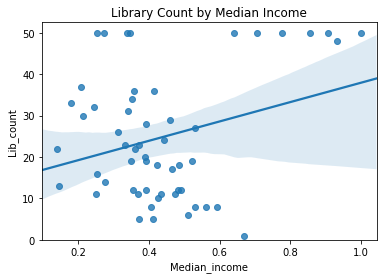

In [40]:
#start with Median Income
sns.regplot(x='Median_income', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by Median Income')

In [41]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['Median_income'], census_geo_df['Lib_count'])
print('For median income, the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For median income, the Pearson Correlation Coefficient is 0.2905335319543761 and the P-value is 0.03141178274275628


The Pearson coefficient, being about 0.29, can be considered a small-to-medium-sized correlation, and the P-value is less than 0.05, so we have a moderately good certainty about that level of correlation.

Now what about the disability variable?

Text(0.5,1,'Library Count by Percent with Disability')

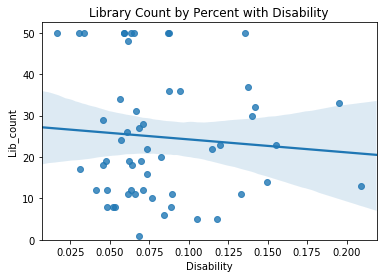

In [42]:
sns.regplot(x='Disability', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by Percent with Disability')

In [43]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['Disability'], census_geo_df['Lib_count'])
print('For disability, the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For disability, the Pearson Correlation Coefficient is -0.08229834650185794 and the P-value is 0.550282574789148


The Pearson coefficient is very close to 0, and we can tell from the plot that the points are scattered all over with weak adherence to the fit line, so the correlation is very small. The P-value, however, is fairly large, which means we don't have a very good certainty about this fit.

Let's look at the White variable next:

Text(0.5,1,'Library Count by White Population')

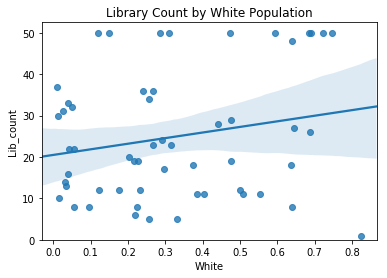

In [44]:
sns.regplot(x='White', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by White Population')

In [45]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['White'], census_geo_df['Lib_count'])
print('For white percentage of population, the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For white percentage of population, the Pearson Correlation Coefficient is 0.20640988689946818 and the P-value is 0.130546467752565


Another small correlation with a rather weak certainty. Let's look at Poverty Rate next:

Text(0.5,1,'Library Count by Poverty Rate')

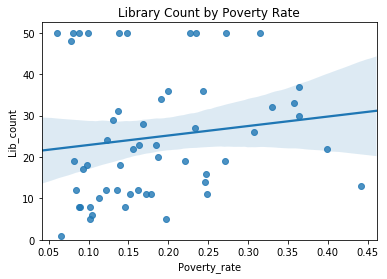

In [46]:
sns.regplot(x='Poverty_rate', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by Poverty Rate')

In [47]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['Poverty_rate'], census_geo_df['Lib_count'])
print('For poverty rate, the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For poverty rate, the Pearson Correlation Coefficient is 0.13971334940713862 and the P-value is 0.3089900911152646


So Poverty Rate is another variable where we have weak certainty of a small correlation. How about Foreign-born?

Text(0.5,1,'Library Count by Percent Born Outside the U.S.')

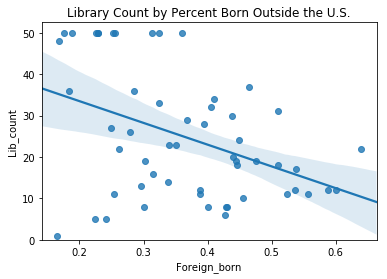

In [48]:
sns.regplot(x='Foreign_born', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by Percent Born Outside the U.S.')

In [49]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['Foreign_born'], census_geo_df['Lib_count'])
print('For percentage of population born outside the U.S., the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For percentage of population born outside the U.S., the Pearson Correlation Coefficient is -0.4147762539334712 and the P-value is 0.0016408065193716272


This correlation is somewhat higher than the others; it could be considered a medium correlation (about which we are very certain, since the P-value is so low). This means we are certain that the number of libraries does decrease in areas with a higher percentage of population born outside of the United States.

Lastly, what about Over-65?

Text(0.5,1,'Library Count by Percent Over Age 65')

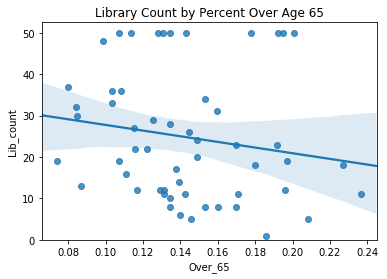

In [50]:
sns.regplot(x='Over_65', y='Lib_count', data=census_geo_df)
plt.ylim(0,)
plt.title('Library Count by Percent Over Age 65')

In [51]:
pearson_coef, p_value = stats.pearsonr(census_geo_df['Over_65'], census_geo_df['Lib_count'])
print('For percentage of population over age 65, the Pearson Correlation Coefficient is {} and the P-value is {}'.format(pearson_coef, p_value))

For percentage of population over age 65, the Pearson Correlation Coefficient is -0.16916125306041113 and the P-value is 0.21696490207440577


After examining all these plots and statistics, we can say that Median Income and Foreign-Born are the two largest correlations out of all of the variables, and the certainty of the correlation is strongest. The strength of the correlation is only moderate in both cases, but nonetheless it does exist.